In [ ]:
import cv2
import os
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
import seaborn as sns
from tqdm import tqdm

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
import os
import pandas as pd

# ระบุ path ที่เก็บรูปภาพไว้
sdir = r'/content/drive/MyDrive/model'
filenames = []
fullpaths = []
labels = []
classlist = os.listdir(sdir)

# ทำซ้ำในการเก็บข้อมูลชื่อไฟล์ และ path ของไฟล์ เก็บไว้ใน list ต่างๆ
for klass in classlist:
    classpath = os.path.join(sdir, klass)
    flist = os.listdir(classpath)
    for i, f in enumerate(flist):
        fpath = os.path.join(classpath, f)
        filenames.append(f)
        fullpaths.append(fpath)
        labels.append(klass)

# นำ list ของข้อมูลที่ได้ มาทำเป็น dataframe
df = pd.DataFrame({
    'fullpaths': fullpaths,
    'filenames': filenames,
    'labels': labels
})

# แสดง dataframe
print(df)


                                             fullpaths  \
0    /content/drive/MyDrive/model/Sweet/IMG_2023121...   
1    /content/drive/MyDrive/model/Sweet/IMG_2023121...   
2    /content/drive/MyDrive/model/Sweet/IMG_2023121...   
3    /content/drive/MyDrive/model/Sweet/IMG_2023121...   
4    /content/drive/MyDrive/model/Sweet/IMG_2023121...   
..                                                 ...   
220  /content/drive/MyDrive/model/LessSweet/IMG_202...   
221  /content/drive/MyDrive/model/LessSweet/IMG_202...   
222  /content/drive/MyDrive/model/LessSweet/IMG_202...   
223  /content/drive/MyDrive/model/LessSweet/IMG_202...   
224  /content/drive/MyDrive/model/LessSweet/IMG_202...   

                       filenames     labels  
0        IMG_20231219_191935.jpg      Sweet  
1        IMG_20231219_191932.jpg      Sweet  
2        IMG_20231219_191937.jpg      Sweet  
3        IMG_20231219_191940.jpg      Sweet  
4        IMG_20231219_191930.jpg      Sweet  
..                         

In [ ]:
df[['filenames','labels']].sample(20)

,filenames,labels
118,IMG_20231219_191629.jpg,Nosweet
96,IMG_20231219_191535.jpg,Nosweet
134,IMG_20231220_192753.jpg,Nosweet
182,IMG_20231216_134410.jpg,LessSweet
49,IMG_20231219_192052.jpg,Sweet
192,rrt.jpg,LessSweet
89,IMG_20231219_191326.jpg,Nosweet
148,IMG_20231220_192810.jpg,Nosweet
29,IMG_20231219_192004.jpg,Sweet
164,IMG_20231216_134438 (1).jpg,LessSweet


In [ ]:
df.labels.value_counts()

Sweet        75
Nosweet      75
LessSweet    75
Name: labels, dtype: int64

Sweet        75
Nosweet      75
LessSweet    75
Name: labels, dtype: int64


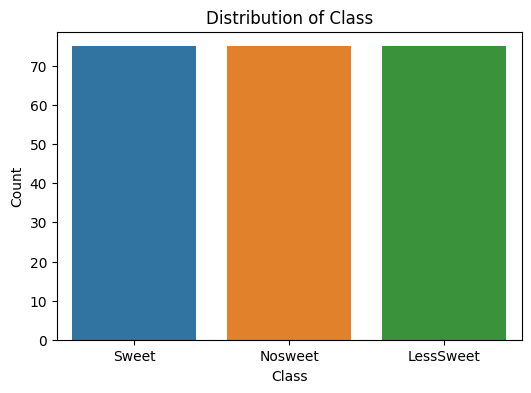

In [ ]:
# แสดงจำนวนของแต่ละคลาสในคอลัมน์ 'Class'
class_counts = df['labels'].value_counts()
print(class_counts)

# แสดงการกระจายตัวของคลาสในคอลัมน์ 'Class'
plt.figure(figsize=(6, 4))
sns.countplot(data=df, x='labels')
plt.title('Distribution of Class')
plt.xlabel('Class')
plt.ylabel('Count')
plt.show()

In [ ]:
# อ่านภาพแถวที่ 1 ของ dataframe โดยใช้โมดูล cv2
sample_image = cv2.imread(df['fullpaths'][0])
# แสดงความกว้าง, ยาว, และจำนวน channels ของรูปภาพ
print('shape of image:', sample_image.shape)
# แสดง array ของรูปภาพ
print(sample_image)

shape of image: (3000, 4000, 3)
[[[179 182 187]
  [179 182 187]
  [179 182 187]
  ...
  [119 122 126]
  [121 124 128]
  [121 124 128]]

 [[180 183 188]
  [180 183 188]
  [180 183 188]
  ...
  [118 121 125]
  [121 124 128]
  [120 123 127]]

 [[181 184 189]
  [181 184 189]
  [181 184 189]
  ...
  [119 122 126]
  [122 125 129]
  [120 123 127]]

 ...

 [[180 184 189]
  [180 184 189]
  [180 184 189]
  ...
  [176 180 185]
  [177 181 186]
  [178 182 187]]

 [[179 183 188]
  [180 184 189]
  [180 184 189]
  ...
  [174 178 183]
  [176 180 185]
  [177 181 186]]

 [[179 183 188]
  [179 183 188]
  [179 183 188]
  ...
  [176 180 185]
  [176 180 185]
  [174 178 183]]]


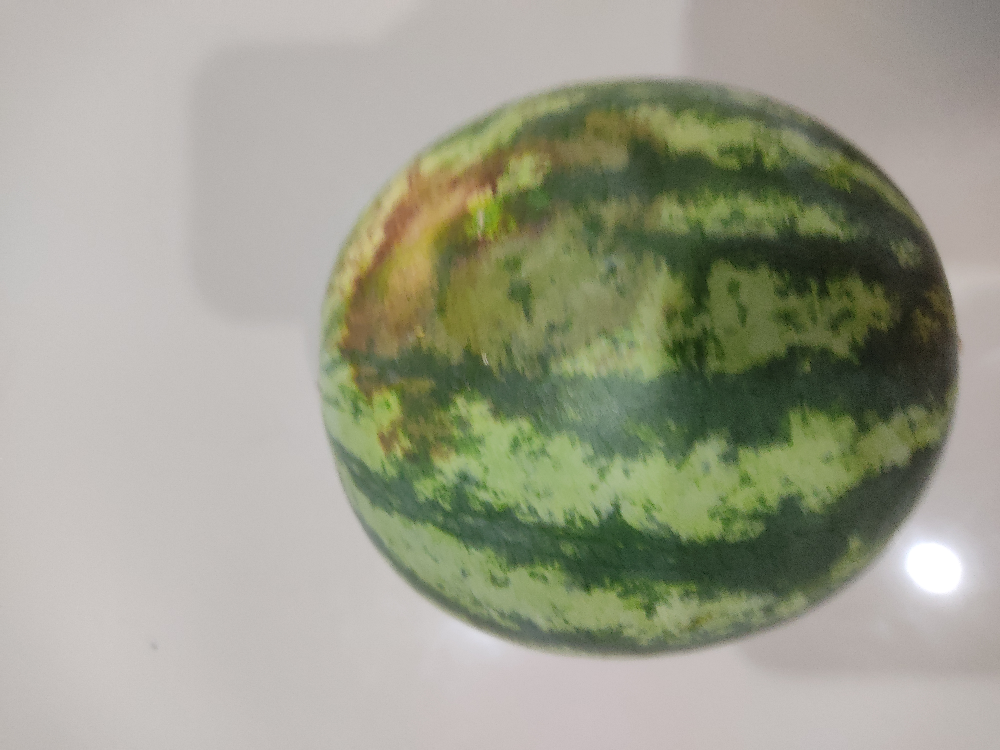

In [ ]:
# แสดงภาพที่อ่านมา
#cv2.imshow('Sample_image', sample_image)
#cv2.waitKey(0)
#cv2.destroyAllWindows()
from google.colab.patches import cv2_imshow

# แสดงภาพที่อ่านมา
cv2_imshow(sample_image)
cv2.waitKey(0)
cv2.destroyAllWindows()

(3000, 4000, 3)


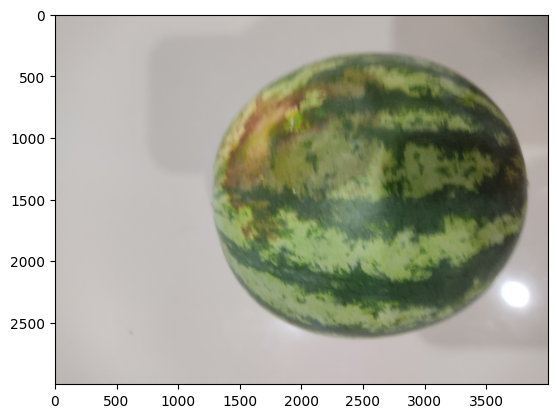

In [ ]:
# โดยปกติแล้วการอ่านภาพของโมดูล cv2 แรกเริ่มจะเป็น BGR Format, เราจึงจะเปลี่ยนให้เป็น RGB format
sample_image = cv2.cvtColor(sample_image, cv2.COLOR_BGR2RGB)
# แสดงความกว้าง, ยาว, และจำนวน channels ของรูปภาพ
print(sample_image.shape)
# แสดงข้อมูล
plt.imshow(sample_image)

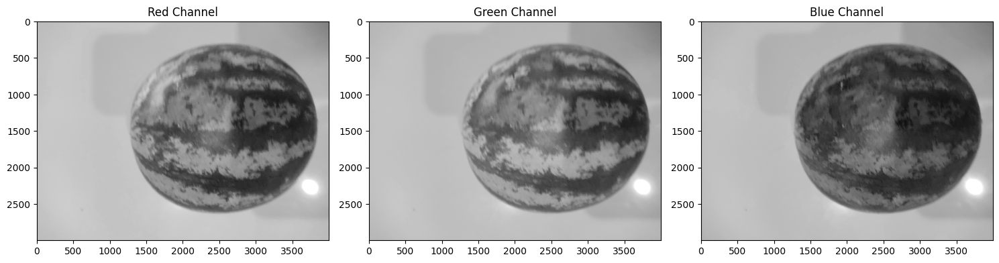

In [ ]:
# สร้าง subplot
plt.figure(figsize=(15, 5))

# แสดงผล Red Channel
plt.subplot(1, 3, 1)
plt.imshow(sample_image[:,:,0], cmap='gray')
plt.title('Red Channel')

# แสดงผล Green Channel
plt.subplot(1, 3, 2)
plt.imshow(sample_image[:,:,1], cmap='gray')
plt.title('Green Channel')

# แสดงผล Blue Channel
plt.subplot(1, 3, 3)
plt.imshow(sample_image[:,:,2], cmap='gray')
plt.title('Blue Channel')

plt.tight_layout()
plt.show()

In [ ]:
# แสดงค่าสีแดงในภาพ
print(sample_image[:, :, 0])
print(sample_image[:, :, 0].shape)

[[187 187 187 ... 126 128 128]
 [188 188 188 ... 125 128 127]
 [189 189 189 ... 126 129 127]
 ...
 [189 189 189 ... 185 186 187]
 [188 189 189 ... 183 185 186]
 [188 188 188 ... 185 185 183]]
(3000, 4000)


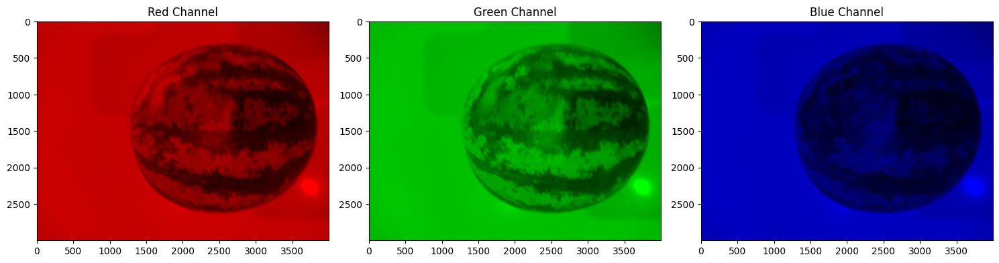

In [ ]:
plt.figure(figsize=(15, 5))

# สร้าง array ที่มีค่า 0 ข้างในทั้งหมด และมีขนาดเท่าภาพจริง
zero_channel = np.zeros_like(sample_image[:,:,0])

# พลอตค่าสีแดง
plt.subplot(1, 3, 1)
red_channel = np.stack([sample_image[:,:,0], zero_channel, zero_channel], axis=2)
plt.imshow(red_channel)
plt.title('Red Channel')

# พลอตค่าสีเขียว
plt.subplot(1, 3, 2)
green_channel = np.stack([zero_channel, sample_image[:,:,1], zero_channel], axis=2)
plt.imshow(green_channel)
plt.title('Green Channel')

# พลอตค่าสีฟ้า
plt.subplot(1, 3, 3)
blue_channel = np.stack([zero_channel, zero_channel, sample_image[:,:,2]], axis=2)
plt.imshow(blue_channel)
plt.title('Blue Channel')

plt.tight_layout()
plt.show()

9it [00:18,  2.05s/it]


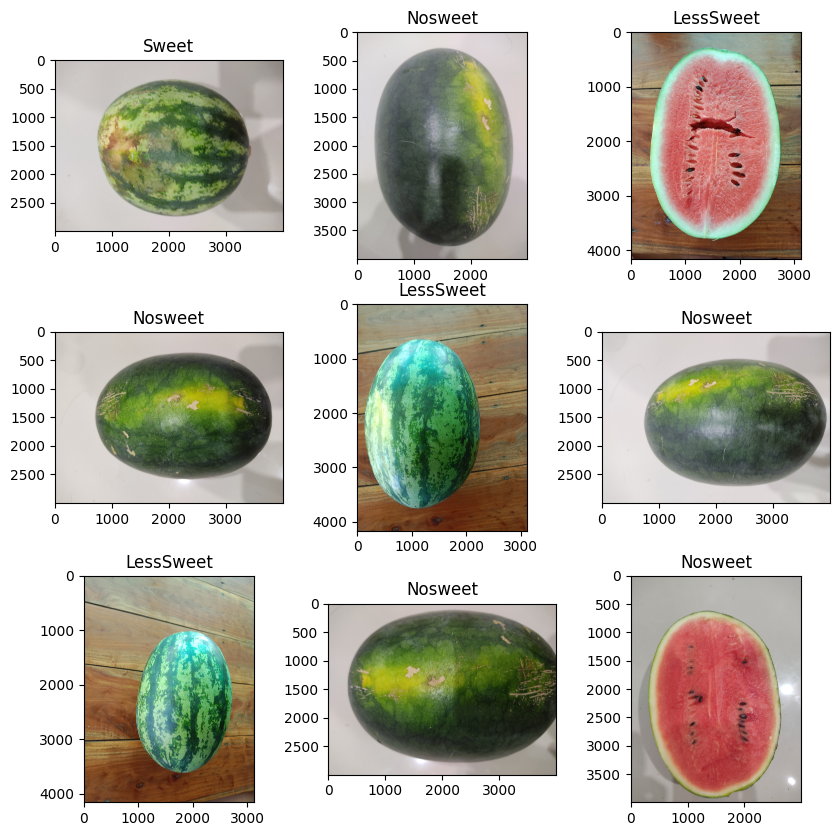

In [ ]:
# แสดงตัวแย่างของภาพใน dataframe
samples = []
sample_labels = []

# สุ่มแถวทั้งหมด 9 แถวใน dataframe เก็บไว้ในตัวแปร sample_rows
sample_rows = df.sample(9)

for index, row in tqdm(sample_rows.iterrows()):
    img_bgr = cv2.imread(row['fullpaths'])
    img_rgb = cv2.cvtColor(img_bgr, cv2.COLOR_BGR2RGB)
    samples.append(img_rgb)
    sample_labels.append(row['labels'])

f, axarr = plt.subplots(3, 3, figsize=(10, 10))
for i in range(3):
    for j in range(3):
        axarr[i, j].imshow(samples[i*3 + j], cmap='gray')
        axarr[i, j].set_title(sample_labels[i*3 + j])
        #axarr[i, j].axis('off')  # สามารถลบ axis ได้เพื่อให้ดูภาพได้ง่ายขึ้น

(3000, 4000, 3)


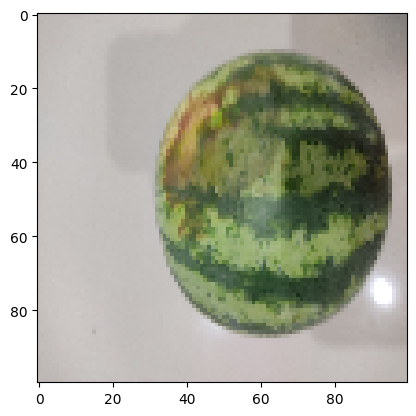

In [ ]:
# คำสั่ง resize รูปภาพ
sample_image_resize = cv2.resize(sample_image,(100,100))
# แสดงความกว้าง, ยาว, และจำนวน channels ของรูปภาพ
print(sample_image.shape)
# แสดงข้อมูล
plt.imshow(sample_image_resize)

In [ ]:
# คำสั่ง .iloc['index'] คือการระบุเลือกแแถว (index) ที่เราต้องการ มันจะ return ข้อมูลทั้งหมดที่มีในแถวนั้นพร้อมชื่อคอลัมน์ด้วย
df.iloc[0]

fullpaths    /content/drive/MyDrive/model/Sweet/IMG_2023121...
filenames                              IMG_20231219_191935.jpg
labels                                                   Sweet
Name: 0, dtype: object

In [ ]:
import os.path

if os.path.exists(sdir):
    img = cv2.imread(sdir)
else:
    print(f"ข้อผิดพลาด: ไม่พบไฟล์ {sdir}")


In [ ]:
# ข้อมูลภาพทั้งหมด จะเก็บไว้ใน list ที่ชื่อ imglist
imglist = []
# ข้อมูล labels จะเก็บไว้ใน list ที่ชื่อ imglabels
imglabels = []

# ทำการอ่านข้อมูล dataframe ทีละแถว อ่านภาพ เก็บภาพใน imglist อ่าน labels เก็บ labels ไว้ใน imglabels
for i in tqdm(range(len(df))):
    image_path = df.iloc[i]['fullpaths'] # path ภาพ
    label = df.iloc[i]['labels'] # label ของภาพนั้น

    img = cv2.imread(image_path) # อ่านภาพจาก path
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    img = cv2.resize(img,(100,100)) # resize ภาพ

    # เก็บภาพและ label ไว้ใน list
    if img is not None:
        imglist.append(img)
        imglabels.append(label)


100%|██████████| 225/225 [06:27<00:00,  1.72s/it]


In [ ]:
# แปลง list ของ images ทั้งหมด เป็น array
img_array = np.array(imglist)
# แสดงผล
print(img_array.shape)

(225, 100, 100, 3)


In [ ]:
# แปลง list ของ labels ทั้งหมด เป็น array
imglabels = np.array(imglabels)
# แสดงผล
imglabels

array(['Sweet', 'Sweet', 'Sweet', 'Sweet', 'Sweet', 'Sweet', 'Sweet',
       'Sweet', 'Sweet', 'Sweet', 'Sweet', 'Sweet', 'Sweet', 'Sweet',
       'Sweet', 'Sweet', 'Sweet', 'Sweet', 'Sweet', 'Sweet', 'Sweet',
       'Sweet', 'Sweet', 'Sweet', 'Sweet', 'Sweet', 'Sweet', 'Sweet',
       'Sweet', 'Sweet', 'Sweet', 'Sweet', 'Sweet', 'Sweet', 'Sweet',
       'Sweet', 'Sweet', 'Sweet', 'Sweet', 'Sweet', 'Sweet', 'Sweet',
       'Sweet', 'Sweet', 'Sweet', 'Sweet', 'Sweet', 'Sweet', 'Sweet',
       'Sweet', 'Sweet', 'Sweet', 'Sweet', 'Sweet', 'Sweet', 'Sweet',
       'Sweet', 'Sweet', 'Sweet', 'Sweet', 'Sweet', 'Sweet', 'Sweet',
       'Sweet', 'Sweet', 'Sweet', 'Sweet', 'Sweet', 'Sweet', 'Sweet',
       'Sweet', 'Sweet', 'Sweet', 'Sweet', 'Sweet', 'Nosweet', 'Nosweet',
       'Nosweet', 'Nosweet', 'Nosweet', 'Nosweet', 'Nosweet', 'Nosweet',
       'Nosweet', 'Nosweet', 'Nosweet', 'Nosweet', 'Nosweet', 'Nosweet',
       'Nosweet', 'Nosweet', 'Nosweet', 'Nosweet', 'Nosweet', 'Nosweet',
       

In [ ]:
# นำเข้าไลบรารี keras.utils เพื่อเรียกใช้ to_categorical
from keras.utils import to_categorical
# นำเข้าไลบรารี sklearn.preprocessing เพื่อเรียกใช้ LabelEncoder
from sklearn.preprocessing import LabelEncoder

In [ ]:
# สร้าง LabelEncoder ไว้ในตัวแปร label_encoder
label_encoder = LabelEncoder()
# Encode ข้อมูล จาก str เป็น int
integer_encoded = label_encoder.fit_transform(labels)
# แสดงผล

print(labels)
integer_encoded

['Sweet', 'Sweet', 'Sweet', 'Sweet', 'Sweet', 'Sweet', 'Sweet', 'Sweet', 'Sweet', 'Sweet', 'Sweet', 'Sweet', 'Sweet', 'Sweet', 'Sweet', 'Sweet', 'Sweet', 'Sweet', 'Sweet', 'Sweet', 'Sweet', 'Sweet', 'Sweet', 'Sweet', 'Sweet', 'Sweet', 'Sweet', 'Sweet', 'Sweet', 'Sweet', 'Sweet', 'Sweet', 'Sweet', 'Sweet', 'Sweet', 'Sweet', 'Sweet', 'Sweet', 'Sweet', 'Sweet', 'Sweet', 'Sweet', 'Sweet', 'Sweet', 'Sweet', 'Sweet', 'Sweet', 'Sweet', 'Sweet', 'Sweet', 'Sweet', 'Sweet', 'Sweet', 'Sweet', 'Sweet', 'Sweet', 'Sweet', 'Sweet', 'Sweet', 'Sweet', 'Sweet', 'Sweet', 'Sweet', 'Sweet', 'Sweet', 'Sweet', 'Sweet', 'Sweet', 'Sweet', 'Sweet', 'Sweet', 'Sweet', 'Sweet', 'Sweet', 'Sweet', 'Nosweet', 'Nosweet', 'Nosweet', 'Nosweet', 'Nosweet', 'Nosweet', 'Nosweet', 'Nosweet', 'Nosweet', 'Nosweet', 'Nosweet', 'Nosweet', 'Nosweet', 'Nosweet', 'Nosweet', 'Nosweet', 'Nosweet', 'Nosweet', 'Nosweet', 'Nosweet', 'Nosweet', 'Nosweet', 'Nosweet', 'Nosweet', 'Nosweet', 'Nosweet', 'Nosweet', 'Nosweet', 'Nosweet', 'Nosw

array([2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2,
       2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2,
       2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2,
       2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0])

In [ ]:
# Encode ข้อมูล จาก int เป็น one-hot
imglabels = to_categorical(integer_encoded)
# แสดงผล
print(imglabels)

[[0. 0. 1.]
 [0. 0. 1.]
 [0. 0. 1.]
 [0. 0. 1.]
 [0. 0. 1.]
 [0. 0. 1.]
 [0. 0. 1.]
 [0. 0. 1.]
 [0. 0. 1.]
 [0. 0. 1.]
 [0. 0. 1.]
 [0. 0. 1.]
 [0. 0. 1.]
 [0. 0. 1.]
 [0. 0. 1.]
 [0. 0. 1.]
 [0. 0. 1.]
 [0. 0. 1.]
 [0. 0. 1.]
 [0. 0. 1.]
 [0. 0. 1.]
 [0. 0. 1.]
 [0. 0. 1.]
 [0. 0. 1.]
 [0. 0. 1.]
 [0. 0. 1.]
 [0. 0. 1.]
 [0. 0. 1.]
 [0. 0. 1.]
 [0. 0. 1.]
 [0. 0. 1.]
 [0. 0. 1.]
 [0. 0. 1.]
 [0. 0. 1.]
 [0. 0. 1.]
 [0. 0. 1.]
 [0. 0. 1.]
 [0. 0. 1.]
 [0. 0. 1.]
 [0. 0. 1.]
 [0. 0. 1.]
 [0. 0. 1.]
 [0. 0. 1.]
 [0. 0. 1.]
 [0. 0. 1.]
 [0. 0. 1.]
 [0. 0. 1.]
 [0. 0. 1.]
 [0. 0. 1.]
 [0. 0. 1.]
 [0. 0. 1.]
 [0. 0. 1.]
 [0. 0. 1.]
 [0. 0. 1.]
 [0. 0. 1.]
 [0. 0. 1.]
 [0. 0. 1.]
 [0. 0. 1.]
 [0. 0. 1.]
 [0. 0. 1.]
 [0. 0. 1.]
 [0. 0. 1.]
 [0. 0. 1.]
 [0. 0. 1.]
 [0. 0. 1.]
 [0. 0. 1.]
 [0. 0. 1.]
 [0. 0. 1.]
 [0. 0. 1.]
 [0. 0. 1.]
 [0. 0. 1.]
 [0. 0. 1.]
 [0. 0. 1.]
 [0. 0. 1.]
 [0. 0. 1.]
 [0. 1. 0.]
 [0. 1. 0.]
 [0. 1. 0.]
 [0. 1. 0.]
 [0. 1. 0.]
 [0. 1. 0.]
 [0. 1. 0.]
 [0. 1. 0.]
 [0.

In [ ]:
from sklearn.model_selection import train_test_split

In [ ]:
X_train, X_test, y_train, y_test = train_test_split(img_array, imglabels, train_size=0.7, random_state=42, stratify=imglabels)

In [ ]:
print('length of X_train:',len(X_train),', length of X_test:', len(X_test))

length of X_train: 157 , length of X_test: 68


In [ ]:

print('shape of X_train:', X_train.shape)
print('shape of X_test:', X_test.shape)
print('shape of y_train:', y_train.shape)
print('shape of y_test:', y_test.shape)

shape of X_train: (157, 100, 100, 3)
shape of X_test: (68, 100, 100, 3)
shape of y_train: (157, 3)
shape of y_test: (68, 3)


In [ ]:
# นำเข้าไลบรารี tensorflow.keras.models เพื่อเรียกใช้ Sequential
from tensorflow.keras.models import Sequential
# นำเข้าไลบรารี tensorflow.keras.layers เพื่อเรียกใช้ CNNs และ FCs
from tensorflow.keras.layers import Conv2D, MaxPooling2D, Flatten, Dense, Dropout

In [ ]:
# สร้างโมเดล
model = Sequential()

# First convolutional layer
model.add(Conv2D(100, (3, 3), activation='relu', input_shape=(100, 100, 3)))

# เพิ่ม Hidden layers อื่นๆ ของ CNNs
model.add(MaxPooling2D((2, 2)))
model.add(Conv2D(64, (3, 3), activation='relu'))
model.add(Conv2D(64, (3, 3), activation='relu'))

# ดูภาพรวมของโมเดล
model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 98, 98, 100)       2800      
                                                                 
 max_pooling2d (MaxPooling2  (None, 49, 49, 100)       0         
 D)                                                              
                                                                 
 conv2d_1 (Conv2D)           (None, 47, 47, 64)        57664     
                                                                 
 conv2d_2 (Conv2D)           (None, 45, 45, 64)        36928     
                                                                 
Total params: 97392 (380.44 KB)
Trainable params: 97392 (380.44 KB)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________


In [ ]:
# คัดลอกโมเดลที่มีแค่ส่วน CNNs เก็บไว้ในคัวแปร feature_map_model
feature_map_model = Sequential(model)

In [ ]:
# ป้อนภาพที่ 1-10 ใน X_train เข้าไปในโมเดล โมเดลจะทำ Convolution กับภาพ และได้ผลลัพธ์ออกมาเป็น feature maps
feature_maps = feature_map_model.predict(X_train[0:11])

1/1 [==============================] - 2s 2s/step


Shape of the final feature maps: (11, 45, 45, 64)


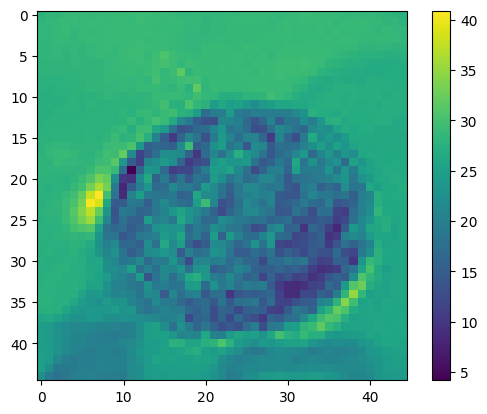

In [ ]:
# ดู shape ของ feature maps ที่ได้
print("Shape of the final feature maps:", feature_maps.shape)

# แสดงภาพ feature maps ที่ได้
plt.imshow(feature_maps[0, :, :, 0], cmap='viridis')
plt.colorbar()
plt.show()

In [ ]:
# เพิ่ม Flatten Layer
model.add(Flatten())

# ดูภาพรวมของโมเดล
model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 98, 98, 100)       2800      
                                                                 
 max_pooling2d (MaxPooling2  (None, 49, 49, 100)       0         
 D)                                                              
                                                                 
 conv2d_1 (Conv2D)           (None, 47, 47, 64)        57664     
                                                                 
 conv2d_2 (Conv2D)           (None, 45, 45, 64)        36928     
                                                                 
 flatten (Flatten)           (None, 129600)            0         
                                                                 
Total params: 97392 (380.44 KB)
Trainable params: 97392 (380.44 KB)
Non-trainable params: 0 (0.00 Byte)
__________________

In [ ]:
# เพิ่ม Fully-connected layers ในโมเดล
model.add(Dense(64, activation='relu'))
model.add(Dropout(0.25))
model.add(Dense(32, activation='relu'))
model.add(Dropout(0.25))

model.add(Dense(3, activation='softmax')) # เนื่องจากเรามี 3 classes จึงต้องใช้ Softmax 3 nodes

In [ ]:
model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 98, 98, 100)       2800      
                                                                 
 max_pooling2d (MaxPooling2  (None, 49, 49, 100)       0         
 D)                                                              
                                                                 
 conv2d_1 (Conv2D)           (None, 47, 47, 64)        57664     
                                                                 
 conv2d_2 (Conv2D)           (None, 45, 45, 64)        36928     
                                                                 
 flatten (Flatten)           (None, 129600)            0         
                                                                 
 dense (Dense)               (None, 64)                8294464   
                                                        

In [ ]:

model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])

In [ ]:
print(y_train.shape)


(157, 3)


Epoch 1/50
2/2 [==============================] - 8s 2s/step - loss: 139.9178 - accuracy: 0.3760 - val_loss: 244.0149 - val_accuracy: 0.2812
Epoch 2/50
2/2 [==============================] - 0s 78ms/step - loss: 192.1677 - accuracy: 0.3600 - val_loss: 49.7272 - val_accuracy: 0.2812
Epoch 3/50
2/2 [==============================] - 0s 71ms/step - loss: 50.1353 - accuracy: 0.3360 - val_loss: 7.7055 - val_accuracy: 0.4375
Epoch 4/50
2/2 [==============================] - 0s 88ms/step - loss: 12.9831 - accuracy: 0.4160 - val_loss: 1.0646 - val_accuracy: 0.5312
Epoch 5/50
2/2 [==============================] - 0s 78ms/step - loss: 5.5858 - accuracy: 0.3840 - val_loss: 3.0693 - val_accuracy: 0.4375
Epoch 6/50
2/2 [==============================] - 0s 72ms/step - loss: 3.6599 - accuracy: 0.4000 - val_loss: 1.3297 - val_accuracy: 0.4062
Epoch 7/50
2/2 [==============================] - 0s 76ms/step - loss: 1.7027 - accuracy: 0.4160 - val_loss: 0.7390 - val_accuracy: 0.6562
Epoch 8/50
2/2 [====

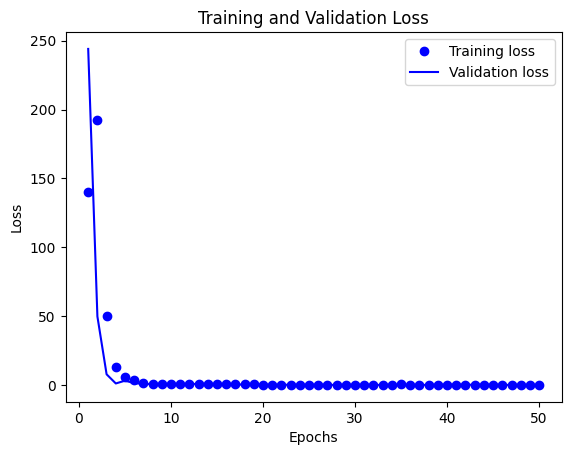

In [ ]:
# เทรนโมเดล
def plot_history(history):
    # ดึงข้อมูล loss และ validation loss จาก history
    loss = history.history['loss']
    val_loss = history.history['val_loss']

    # พล็อตกราฟ loss และ validation loss
    epochs = range(1, len(loss) + 1)
    plt.plot(epochs, loss, 'bo', label='Training loss')
    plt.plot(epochs, val_loss, 'b', label='Validation loss')
    plt.title('Training and Validation Loss')
    plt.xlabel('Epochs')
    plt.ylabel('Loss')
    plt.legend()

    plt.show()
history = model.fit(X_train, y_train, epochs=50, batch_size=100, validation_split=0.2, verbose=1)
plot_history(history)

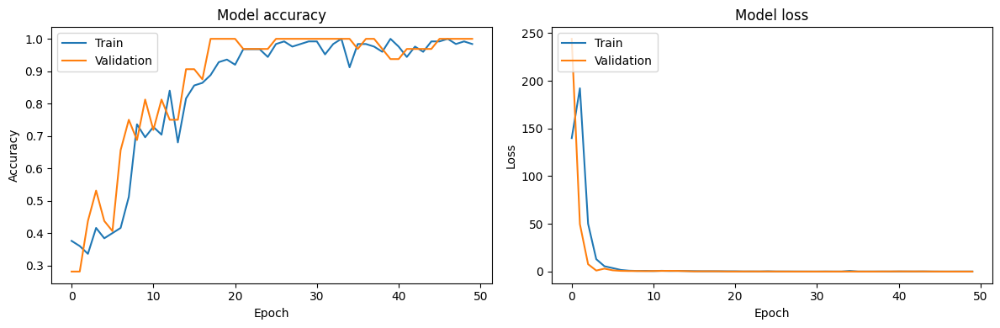

In [ ]:
plt.figure(figsize=(12, 4))

plt.subplot(1, 2, 1)
plt.plot(history.history['accuracy'])
plt.plot(history.history['val_accuracy'])
plt.title('Model accuracy')
plt.ylabel('Accuracy')
plt.xlabel('Epoch')
plt.legend(['Train', 'Validation'], loc='upper left')


plt.subplot(1, 2, 2)
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('Model loss')
plt.ylabel('Loss')
plt.xlabel('Epoch')
plt.legend(['Train', 'Validation'], loc='upper left')

plt.tight_layout()
plt.show()

In [ ]:
y_pred = model.predict(X_test)
print(y_pred)

3/3 [==============================] - 1s 347ms/step
[[1.00000000e+00 2.01512623e-26 4.92310397e-18]
 [2.71937577e-04 9.99707282e-01 2.07915309e-05]
 [9.99998093e-01 4.01653732e-09 1.88168667e-06]
 [1.52127890e-04 9.99273241e-01 5.74629463e-04]
 [2.58281618e-09 3.51914969e-10 1.00000000e+00]
 [3.94375529e-03 6.13385439e-03 9.89922345e-01]
 [1.00000000e+00 9.00646193e-27 1.55109388e-16]
 [5.70448310e-06 4.14964097e-06 9.99990106e-01]
 [1.13358156e-10 1.19541363e-10 1.00000000e+00]
 [1.21726433e-08 9.28612590e-01 7.13874251e-02]
 [8.37247353e-03 7.29632914e-01 2.61994570e-01]
 [6.21056301e-04 9.98102844e-01 1.27604872e-03]
 [9.99994636e-01 2.85163271e-08 5.37558708e-06]
 [1.00000000e+00 7.98714226e-19 6.82579774e-12]
 [2.29050897e-07 3.18828938e-07 9.99999404e-01]
 [4.96276282e-03 1.16030246e-01 8.79006982e-01]
 [1.56328604e-02 2.59664863e-01 7.24702239e-01]
 [2.30561447e-13 1.00000000e+00 4.42451550e-13]
 [1.00000000e+00 9.10512638e-11 1.13278942e-08]
 [1.00000000e+00 2.23949132e-28 7.1

In [ ]:
y_pred = np.argmax(y_pred, axis=1)
y_pred

array([0, 1, 0, 1, 2, 2, 0, 2, 2, 1, 1, 1, 0, 0, 2, 2, 2, 1, 0, 0, 1, 0,
       2, 0, 0, 2, 0, 2, 2, 1, 0, 2, 1, 1, 1, 1, 2, 2, 0, 2, 2, 1, 1, 1,
       1, 1, 0, 2, 1, 2, 0, 1, 0, 2, 1, 1, 1, 0, 2, 1, 1, 0, 0, 0, 0, 0,
       2, 0])

In [ ]:
y_test =  np.argmax(y_test, axis=1)

print('y_pred: \n', y_pred)
print()
print('y_test: \n', y_test)

y_pred: 
 [0 1 0 1 2 2 0 2 2 1 1 1 0 0 2 2 2 1 0 0 1 0 2 0 0 2 0 2 2 1 0 2 1 1 1 1 2
 2 0 2 2 1 1 1 1 1 0 2 1 2 0 1 0 2 1 1 1 0 2 1 1 0 0 0 0 0 2 0]

y_test: 
 [0 1 0 1 2 2 0 2 2 2 2 1 0 0 2 1 1 1 0 0 1 0 2 0 0 2 0 2 2 1 0 2 1 1 1 1 2
 2 0 2 2 1 1 1 1 1 0 2 1 2 0 1 0 2 1 1 1 0 2 2 1 0 0 0 0 0 2 0]


In [ ]:
from sklearn.metrics import confusion_matrix

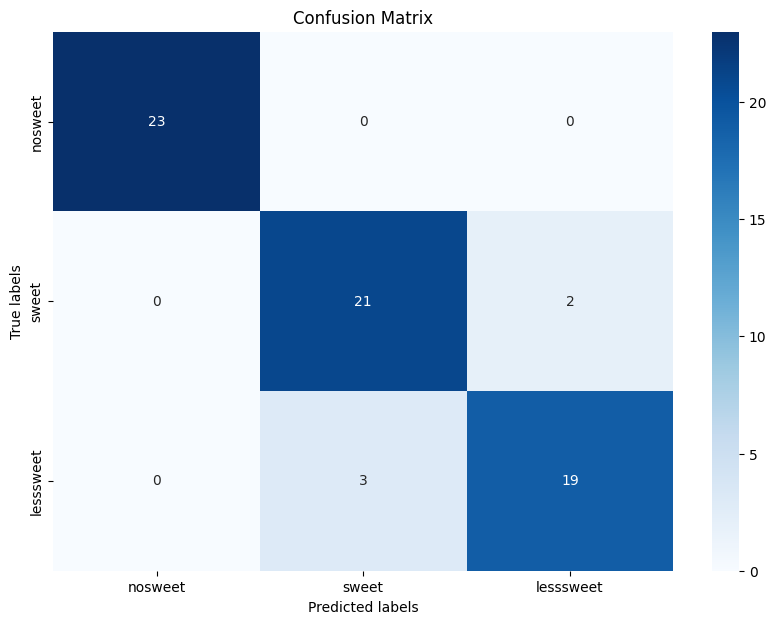

In [ ]:

cm = confusion_matrix(y_test, y_pred)
label = ['nosweet','sweet','lesssweet']

plt.figure(figsize=(10, 7))
sns.heatmap(cm, annot=True, fmt='g', cmap='Blues', xticklabels=label, yticklabels=label)
plt.xlabel('Predicted labels')
plt.ylabel('True labels')
plt.title('Confusion Matrix')
plt.show()

In [ ]:
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, matthews_corrcoef

In [ ]:
# คำนวณผลของ metrics ต่างๆ
accuracy = accuracy_score(y_test, y_pred)
precision = precision_score(y_test, y_pred, average='macro')
recall = recall_score(y_test, y_pred, average='macro')
f1 = f1_score(y_test, y_pred, average='macro')
mcc = matthews_corrcoef(y_test, y_pred)


print(f"ความแม่นยำ (Accuracy): {accuracy:.4f}")
print(f"ความแม่นยำของการทำนายคลาสบวก (Precision): {precision:.4f}")
print(f"ความครอบคลุม (Recall): {recall:.4f}")
print(f"คะแนน F1 (F1-Score): {f1:.4f}")
print(f"ค่าสหสัมพันธ์แมทธิว (MCC): {mcc:.4f}")

ความแม่นยำ (Accuracy): 0.9265
ความแม่นยำของการทำนายคลาสบวก (Precision): 0.9266
ความครอบคลุม (Recall): 0.9256
คะแนน F1 (F1-Score): 0.9258
ค่าสหสัมพันธ์แมทธิว (MCC): 0.8899


In [ ]:
from sklearn.metrics import classification_report # นำเข้าไลบรารี sklearn.metrics เพื่อเรียกใช้ classification_report

In [ ]:
# คำสั่งเรียกดู classification report
report = classification_report(y_test, y_pred)
# แสดงผล
print(report)

              precision    recall  f1-score   support

           0       1.00      1.00      1.00        23
           1       0.88      0.91      0.89        23
           2       0.90      0.86      0.88        22

    accuracy                           0.93        68
   macro avg       0.93      0.93      0.93        68
weighted avg       0.93      0.93      0.93        68



In [ ]:

# บันทึกโมเดลเป็นไฟล์ HDF5
model.save("model3.h5")


1/1 [==============================] - 2s 2s/step


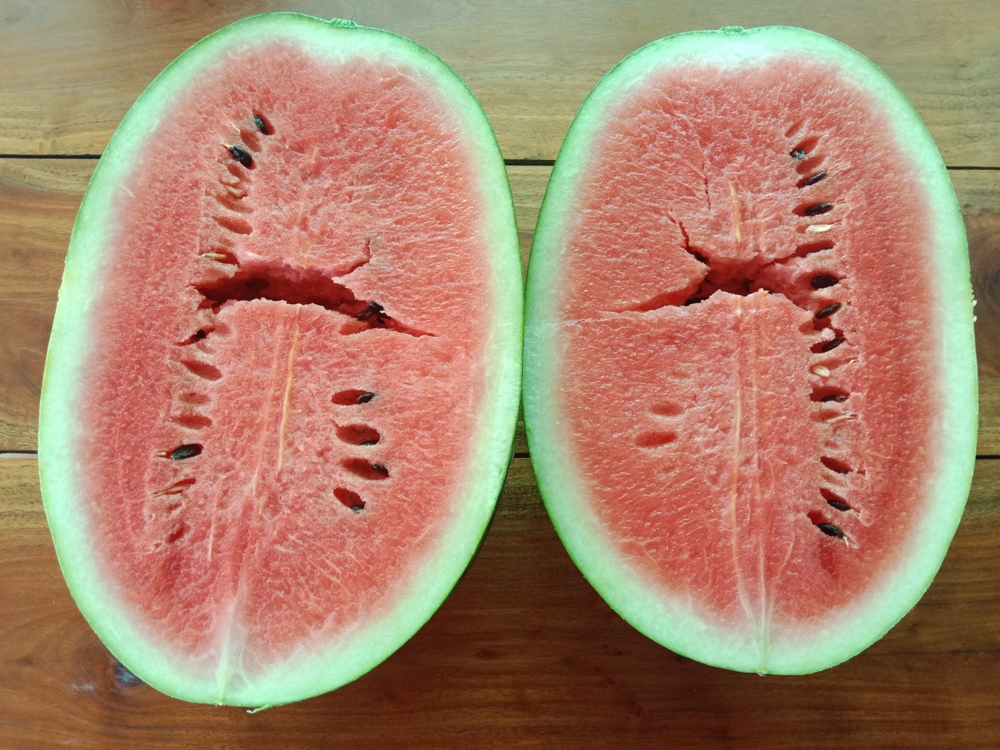

In [ ]:
import cv2
import tensorflow as tf
import numpy as np
from google.colab.patches import cv2_imshow

# โหลดโมเดล
model = tf.keras.models.load_model('model2.h5')

# ฟังก์ชันประมวลผลภาพ
def image_processing_function(image, model):
    # ปรับขนาดภาพเพื่อให้เข้ากับรูปร่างที่โมเดลคาดหวัง
    resized_image = cv2.resize(image, (100, 100))

    # เพิ่มมิติ batch (None) และปรับสีให้เป็นรูปแบบ RGB (3 ช่อง)
    input_image = np.expand_dims(resized_image, axis=0)

    # ทำการประมวลผลภาพด้วยโมเดล
    predictions = model.predict(input_image)

    # หาคลาสที่มีความน่าจะเป็นสูงที่สุด
    predicted_class = np.argmax(predictions)

    return predictions, predicted_class

# โหลดภาพ
image = cv2.imread('de.jpg')

# ประมวลผลภาพ
predictions, predicted_class = image_processing_function(image, model)

# แสดงผลลัพธ์
cv2_imshow(image)
print("Predictions:", predictions)
print("Predicted Class:", predicted_class)

In [ ]:
import os

from keras.models import load_model
from keras.preprocessing import image
import numpy as np

model = load_model('model2.h5')

# วนลูปที่ layers และแสดงชื่อ Tensor
for layer in model.layers:
    print(f"Layer: {layer.name}")
    for weight in layer.weights:
        print(f"  - Tensor: {weight.name}")

Layer: conv2d_6
  - Tensor: conv2d_6/kernel:0
  - Tensor: conv2d_6/bias:0
Layer: max_pooling2d_2
Layer: conv2d_7
  - Tensor: conv2d_7/kernel:0
  - Tensor: conv2d_7/bias:0
Layer: conv2d_8
  - Tensor: conv2d_8/kernel:0
  - Tensor: conv2d_8/bias:0
Layer: flatten_2
Layer: dense_6
  - Tensor: dense_6/kernel:0
  - Tensor: dense_6/bias:0
Layer: dropout_4
Layer: dense_7
  - Tensor: dense_7/kernel:0
  - Tensor: dense_7/bias:0
Layer: dropout_5
Layer: dense_8
  - Tensor: dense_8/kernel:0
  - Tensor: dense_8/bias:0


In [ ]:
from tensorflow.keras.preprocessing import image
from tensorflow.keras.applications.inception_v3 import preprocess_input, decode_predictions
import numpy as np
import matplotlib.pyplot as plt
# นำเข้าโมเดล (ถ้ายังไม่ได้ import)
from tensorflow.keras.models import load_model

# โหลดโมเดล
loaded_model = load_model("model1.h5")

# โหลดรูปภาพ
img_path = 'IMG_20231216_134410.jpg'
img = image.load_img(img_path, target_size=(32, 32))  # ปรับขนาดให้เข้ากับโมเดลของคุณ

# แปลงรูปภาพเป็น array
img_array = image.img_to_array(img)

# เพิ่มมิติเป็น batch dimension
img_array = np.expand_dims(img_array, axis=0)

# ปรับปรุงข้อมูลรูปภาพ (preprocessing)
img_array = preprocess_input(img_array)

# ทำนาย
predictions = loaded_model.predict(img_array)

# ปรับรูปแบบของ predictions เพื่อให้ตรงกับ (1, 1000)
predictions_expanded = np.expand_dims(predictions[0], axis=0)

# เลือกเฉพาะ Top 3 Predictions
decoded_predictions = decode_predictions(predictions_expanded, top=3)[0]

# แสดงผลลัพธ์
for i, (imagenet_id, label, score) in enumerate(decoded_predictions):
    print(f"{i + 1}: {label} ({score:.2f})")

